# Projet 5: Segmentez des clients d'un site e-commerce

## Nettoyage et analyse exploratoire.

### Sommaire

- <a href="#C2">Importation du jeu de données</a>

- <a href="#C3">Analyse rxploratoire du jeu de données</a>

- <a href="#C4">Création un dataset globale</a>

- <a href="#C5">Geolocalisation des commandes</a>
   
- <a href="#C6">Création un dataset RFM: Recency, Frequency, Monetary</a>

    - <a href="#C7">dataset pour la maintenance de segmentation</a>

- <a href="#C8">Création un dataset RFMS: Recency, Frequency, Monetary, Score</a>

# <a name="C2">Imporatation du jeu de données et nettoyage</a>

In [1]:
%load_ext nb_black
%matplotlib inline

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import folium

from scipy import stats


<IPython.core.display.Javascript object>

In [2]:
pd.options.display.max_rows = 100
pd.options.display.max_columns = 100


<IPython.core.display.Javascript object>

In [3]:
# hide warnings
import warnings
warnings.filterwarnings('ignore')


<IPython.core.display.Javascript object>

In [4]:
orders = pd.read_csv('olist_orders_dataset.csv')
customers = pd.read_csv('olist_customers_dataset.csv')
payments = pd.read_csv('olist_order_payments_dataset.csv')
reviews = pd.read_csv('olist_order_reviews_dataset.csv')
items = pd.read_csv('olist_order_items_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv')
geo = pd.read_csv('olist_geolocation_dataset.csv')
category = pd.read_csv('product_category_name_translation.csv')


<IPython.core.display.Javascript object>

<center>
<img src="pictures/data_schema.png" width="800" alt="data_schema.png"  />
<strong> data schema </strong>
</center>


# <a name="C3">Analyse exploratoire du jeu de données</a>

## orders

In [5]:
orders.head(1)


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00


<IPython.core.display.Javascript object>

In [6]:
orders.shape


(99441, 8)

<IPython.core.display.Javascript object>

In [7]:
orders['order_status'].value_counts().values


array([96478,  1107,   625,   609,   314,   301,     5,     2])

<IPython.core.display.Javascript object>

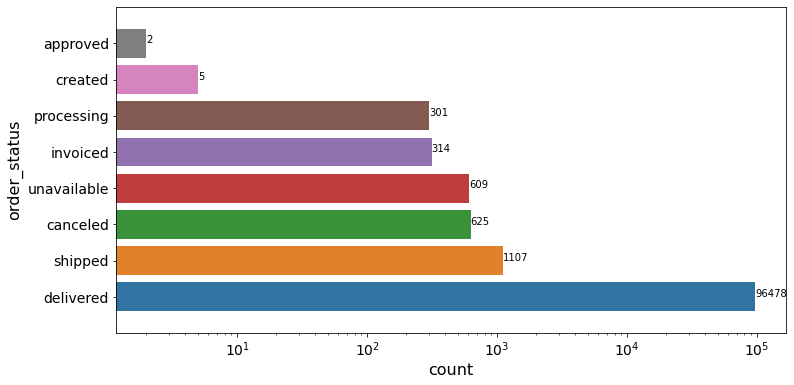

<IPython.core.display.Javascript object>

In [8]:
hbars = orders['order_status'].value_counts().values
plt.figure(figsize=(12, 6))
sns.countplot(y='order_status', data=orders,
              order=orders['order_status'].value_counts().index)
plt.ylabel('order_status', fontsize=16)
plt.yticks(fontsize=14)
plt.ylim(-1, 8)
plt.xlabel('count', fontsize=16)
plt.xticks(fontsize=14)
plt.xscale('log')
for i in range(8):
    plt.annotate(text=hbars[i], xy=(hbars[i], i))
plt.show()


In [9]:
orders['order_purchase_timestamp'] = \
    pd.to_datetime(orders['order_purchase_timestamp'])
orders['order_approved_at'] = pd.to_datetime(orders['order_approved_at'])
orders['order_delivered_carrier_date'] = \
    pd.to_datetime(orders['order_delivered_carrier_date'])
orders['order_delivered_customer_date'] = \
    pd.to_datetime(orders['order_delivered_customer_date'])
orders['order_estimated_delivery_date'] = \
    pd.to_datetime(orders['order_estimated_delivery_date'])


<IPython.core.display.Javascript object>

In [10]:
orders.info(verbose=True, show_counts=True)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       99441 non-null  object        
 1   customer_id                    99441 non-null  object        
 2   order_status                   99441 non-null  object        
 3   order_purchase_timestamp       99441 non-null  datetime64[ns]
 4   order_approved_at              99281 non-null  datetime64[ns]
 5   order_delivered_carrier_date   97658 non-null  datetime64[ns]
 6   order_delivered_customer_date  96476 non-null  datetime64[ns]
 7   order_estimated_delivery_date  99441 non-null  datetime64[ns]
dtypes: datetime64[ns](5), object(3)
memory usage: 6.1+ MB


<IPython.core.display.Javascript object>

In [11]:
orders['order_purchase_year'] = orders['order_purchase_timestamp'].dt.year


<IPython.core.display.Javascript object>

In [12]:
orders['order_purchase_year'].value_counts()


2018    54011
2017    45101
2016      329
Name: order_purchase_year, dtype: int64

<IPython.core.display.Javascript object>

In [13]:
sorted(orders['order_purchase_year'].unique(), reverse=True)


[2018, 2017, 2016]

<IPython.core.display.Javascript object>

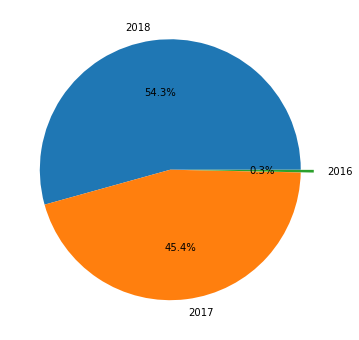

<IPython.core.display.Javascript object>

In [14]:
plt.figure(figsize=(9, 6))
plt.pie(orders['order_purchase_year'].value_counts(),
        labels=sorted(orders['order_purchase_year'].unique(), reverse=True),
        autopct='%.1f%%',
        explode=[0, 0, 0.1])
plt.show()


In [15]:
orders['order_purchase_weekday'] = orders['order_purchase_timestamp']\
                                        .dt.strftime('%A')
orders['order_purchase_weekday'].value_counts()


Monday       16196
Tuesday      15963
Wednesday    15552
Thursday     14761
Friday       14122
Sunday       11960
Saturday     10887
Name: order_purchase_weekday, dtype: int64

<IPython.core.display.Javascript object>

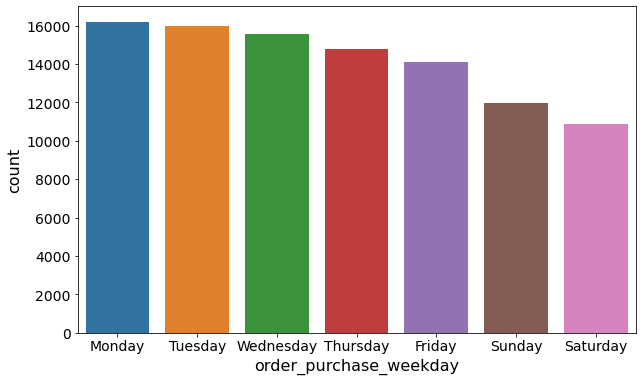

<IPython.core.display.Javascript object>

In [16]:
plt.figure(figsize=(10, 6))
sns.countplot(x='order_purchase_weekday', data=orders,
              order=orders['order_purchase_weekday'].value_counts().index)
plt.xlabel('order_purchase_weekday', fontsize=16)
plt.xticks(fontsize=14)
plt.ylabel('count', fontsize=16)
plt.yticks(fontsize=14)
plt.show()


In [17]:
orders['order_purchase_month'] = \
    orders['order_purchase_timestamp'].dt.strftime('%B')
orders['order_purchase_month'].value_counts()


August       10843
May          10573
July         10318
March         9893
June          9412
April         9343
February      8508
January       8069
November      7544
December      5674
October       4959
September     4305
Name: order_purchase_month, dtype: int64

<IPython.core.display.Javascript object>

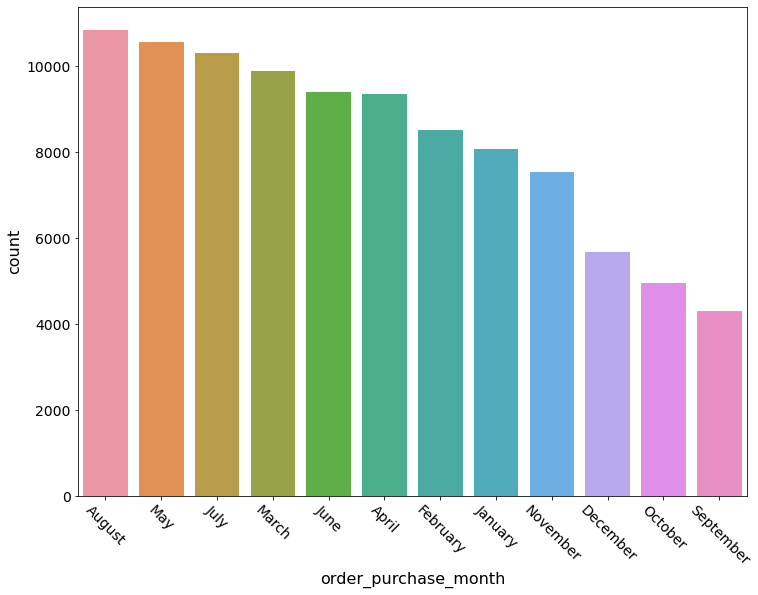

<IPython.core.display.Javascript object>

In [18]:
plt.figure(figsize=(12, 9))
sns.countplot(x='order_purchase_month',
              data=orders,
              order=orders['order_purchase_month'].value_counts().index)
plt.xlabel('order_purchase_month', fontsize=16)
plt.xticks(fontsize=14, rotation=315)
plt.ylabel('count', fontsize=16)
plt.yticks(fontsize=14)
plt.show()


In [19]:
orders['order_purchase_ampm'] = \
    orders['order_purchase_timestamp'].dt.strftime('%p')
orders['order_purchase_ampm'].value_counts()


PM    72461
AM    26980
Name: order_purchase_ampm, dtype: int64

<IPython.core.display.Javascript object>

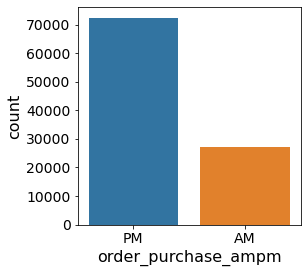

<IPython.core.display.Javascript object>

In [20]:
plt.figure(figsize=(4, 4))
sns.countplot(x='order_purchase_ampm',
              data=orders,
              order=orders['order_purchase_ampm'].value_counts().index)
plt.xlabel('order_purchase_ampm', fontsize=16)
plt.xticks(fontsize=14)
plt.ylabel('count', fontsize=16)
plt.yticks(fontsize=14)
plt.show()


In [21]:
orders['order_purchase_day_month'] = \
    orders['order_purchase_timestamp'].dt.strftime('%d')
orders['order_purchase_day_month'].value_counts()


24    3877
16    3581
15    3524
04    3483
06    3468
05    3445
18    3430
14    3387
19    3364
07    3363
08    3326
11    3308
25    3290
26    3290
03    3283
13    3277
09    3271
20    3261
02    3213
12    3202
17    3200
22    3181
10    3168
23    3128
27    3122
21    3116
01    3101
28    3011
29    2557
30    2534
31    1680
Name: order_purchase_day_month, dtype: int64

<IPython.core.display.Javascript object>

In [22]:
orders[orders['order_purchase_month'] ==
       orders['order_purchase_month'].value_counts().index[0]]


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_year,order_purchase_weekday,order_purchase_month,order_purchase_ampm,order_purchase_day_month
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,2018,Wednesday,August,AM,08
24,f3e7c359154d965827355f39d6b1fdac,62b423aab58096ca514ba6aa06be2f98,delivered,2018-08-09 11:44:40,2018-08-10 03:24:51,2018-08-10 12:29:00,2018-08-13 18:24:27,2018-08-17,2018,Thursday,August,AM,09
30,f70a0aff17df5a6cdd9a7196128bd354,456dc10730fbdba34615447ea195d643,delivered,2017-08-10 11:58:33,2017-08-12 02:45:24,2017-08-17 15:35:07,2017-08-18 14:28:02,2017-08-23,2017,Thursday,August,AM,10
42,948097deef559c742e7ce321e5e58919,8644be24d48806bc3a88fd59fb47ceb1,delivered,2017-08-04 17:10:39,2017-08-04 17:25:11,2017-08-07 17:52:01,2017-08-12 14:08:40,2017-09-01,2017,Friday,August,PM,04
43,d22e9fa5731b9e30e8b27afcdc2f8563,756fb9391752dad934e0fe3733378e57,delivered,2018-08-04 23:25:30,2018-08-04 23:35:13,2018-08-06 15:03:00,2018-08-13 23:34:42,2018-09-13,2018,Saturday,August,PM,04
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99395,5597332b7eded552f104108f22b023e4,aaa423fb52f4106f477683490cbd5845,delivered,2018-08-15 13:03:37,2018-08-15 13:15:22,2018-08-15 14:37:00,2018-08-17 16:06:37,2018-08-21,2018,Wednesday,August,PM,15
99396,b3112ca67f3afd4e20cf2ee91fc4f804,6f83c71b6c044fb156d697d4130fe9b5,delivered,2018-08-02 22:46:54,2018-08-02 23:04:06,2018-08-15 17:42:00,2018-08-21 00:03:26,2018-08-16,2018,Thursday,August,PM,02
99407,c2af225ac9a68a3c24500aa6fab006aa,f93c9e539a9705a57902c625b611e90c,delivered,2018-08-20 10:04:30,2018-08-20 14:53:46,2018-08-22 13:16:00,2018-08-27 21:44:45,2018-08-28,2018,Monday,August,AM,20
99414,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31,2017,Thursday,August,PM,10


<IPython.core.display.Javascript object>

In [23]:
orders['order_purchase_day_year'] = \
    orders['order_purchase_timestamp'].dt.strftime('%j')
orders['order_purchase_day_year'].value_counts().sort_index()


001     74
002    204
003    225
004    258
005    242
      ... 
361    167
362    146
363    135
364     97
365     74
Name: order_purchase_day_year, Length: 365, dtype: int64

<IPython.core.display.Javascript object>

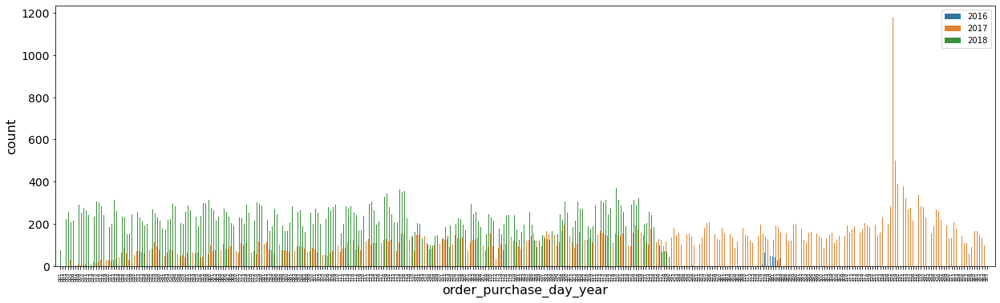

<IPython.core.display.Javascript object>

In [24]:
plt.figure(figsize=(21, 6))
sns.countplot(x='order_purchase_day_year',
              data=orders,
              hue='order_purchase_year',
              order=orders['order_purchase_day_year']
                .value_counts().index.sort_values())
plt.xlabel('order_purchase_day_year', fontsize=16)
plt.xticks(fontsize=6, rotation=90)
plt.xlim(-2, 367)
plt.ylabel('count', fontsize=16)
plt.yticks(fontsize=14)
plt.legend(loc=1)
plt.show()


In [25]:
orders['delivery_time'] = orders['order_delivered_customer_date']\
    .fillna(orders['order_estimated_delivery_date']) - \
    orders['order_purchase_timestamp']
orders['delivery_time'] = orders['delivery_time'].dt.days


<IPython.core.display.Javascript object>

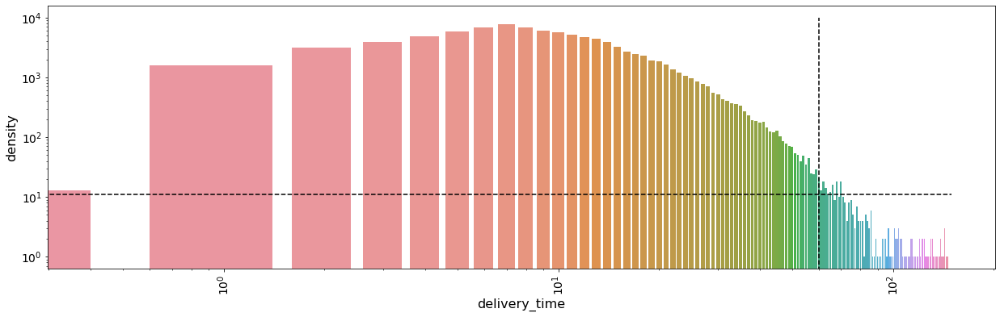

<IPython.core.display.Javascript object>

In [26]:
plt.figure(figsize=(21, 6))
sns.countplot(x='delivery_time',
              data=orders
             )
plt.xlabel('delivery_time', fontsize=16)
plt.xticks(fontsize=14, rotation=90)
plt.xscale('log')
plt.ylabel('density', fontsize=16)
plt.yticks(fontsize=14)
plt.yscale('log')

plt.hlines(y=11, xmin=0, xmax=150, colors='black', linestyle ='dashed')
plt.vlines(x=60, ymin=0, ymax=10000, colors='black', linestyle='dashed')

plt.show()


In [27]:
orders.head(1)


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_year,order_purchase_weekday,order_purchase_month,order_purchase_ampm,order_purchase_day_month,order_purchase_day_year,delivery_time
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,2017,Monday,October,AM,02,275,8


<IPython.core.display.Javascript object>

In [28]:
orders['order_purchase_mm'] = \
    orders['order_purchase_timestamp'].dt.strftime('%m')
orders['order_purchase_mm'].value_counts()


08    10843
05    10573
07    10318
03     9893
06     9412
04     9343
02     8508
01     8069
11     7544
12     5674
10     4959
09     4305
Name: order_purchase_mm, dtype: int64

<IPython.core.display.Javascript object>

In [29]:
orders.groupby(['order_purchase_year']).order_id.apply(lambda x: x.count()).to_frame()


,order_id
order_purchase_year,
2016,329
2017,45101
2018,54011


<IPython.core.display.Javascript object>

In [30]:
orders["order_purchase_year_month"] = orders["order_purchase_timestamp"].dt.strftime(
    "%Y-%m"
)
sorted(orders["order_purchase_year_month"].unique())

['2016-09',
 '2016-10',
 '2016-12',
 '2017-01',
 '2017-02',
 '2017-03',
 '2017-04',
 '2017-05',
 '2017-06',
 '2017-07',
 '2017-08',
 '2017-09',
 '2017-10',
 '2017-11',
 '2017-12',
 '2018-01',
 '2018-02',
 '2018-03',
 '2018-04',
 '2018-05',
 '2018-06',
 '2018-07',
 '2018-08',
 '2018-09',
 '2018-10']

<IPython.core.display.Javascript object>

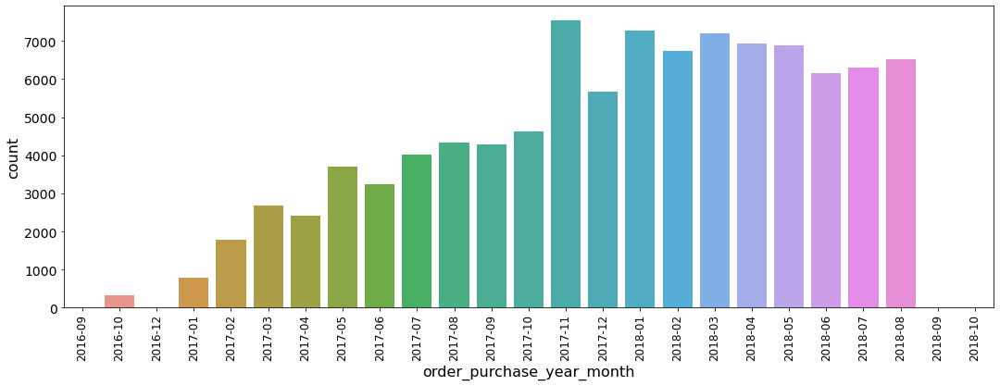

<IPython.core.display.Javascript object>

In [31]:
plt.figure(figsize=(18, 6))
sns.countplot(
    x="order_purchase_year_month",
    data=orders,
    order=sorted(orders["order_purchase_year_month"].unique()),
)
plt.xlabel("order_purchase_year_month", fontsize=16)
plt.xticks(fontsize=12, rotation=90)
plt.ylabel("count", fontsize=16)
plt.yticks(fontsize=14)

plt.show()

In [32]:
orders["order_purchase_year_week"] = orders["order_purchase_timestamp"].dt.strftime(
    "%Y-%W"
)
sorted(orders["order_purchase_year_week"].unique())

['2016-35',
 '2016-36',
 '2016-37',
 '2016-39',
 '2016-40',
 '2016-41',
 '2016-42',
 '2016-51',
 '2017-01',
 '2017-02',
 '2017-03',
 '2017-04',
 '2017-05',
 '2017-06',
 '2017-07',
 '2017-08',
 '2017-09',
 '2017-10',
 '2017-11',
 '2017-12',
 '2017-13',
 '2017-14',
 '2017-15',
 '2017-16',
 '2017-17',
 '2017-18',
 '2017-19',
 '2017-20',
 '2017-21',
 '2017-22',
 '2017-23',
 '2017-24',
 '2017-25',
 '2017-26',
 '2017-27',
 '2017-28',
 '2017-29',
 '2017-30',
 '2017-31',
 '2017-32',
 '2017-33',
 '2017-34',
 '2017-35',
 '2017-36',
 '2017-37',
 '2017-38',
 '2017-39',
 '2017-40',
 '2017-41',
 '2017-42',
 '2017-43',
 '2017-44',
 '2017-45',
 '2017-46',
 '2017-47',
 '2017-48',
 '2017-49',
 '2017-50',
 '2017-51',
 '2017-52',
 '2018-01',
 '2018-02',
 '2018-03',
 '2018-04',
 '2018-05',
 '2018-06',
 '2018-07',
 '2018-08',
 '2018-09',
 '2018-10',
 '2018-11',
 '2018-12',
 '2018-13',
 '2018-14',
 '2018-15',
 '2018-16',
 '2018-17',
 '2018-18',
 '2018-19',
 '2018-20',
 '2018-21',
 '2018-22',
 '2018-23',
 '20

<IPython.core.display.Javascript object>

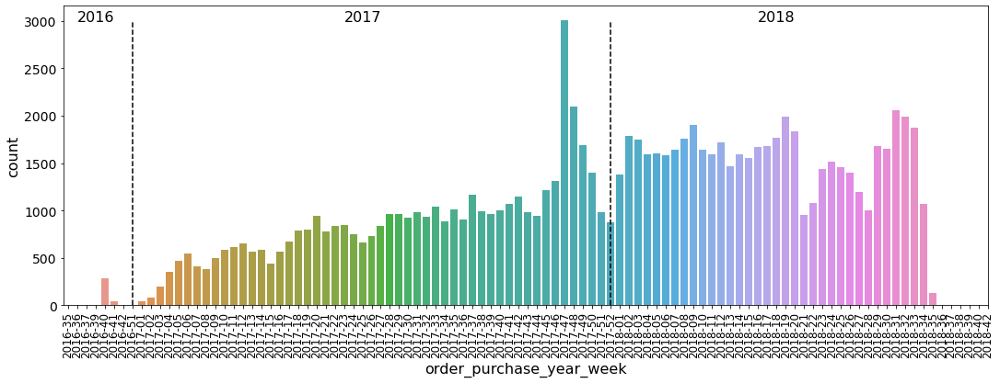

<IPython.core.display.Javascript object>

In [33]:
plt.figure(figsize=(18, 6))
sns.countplot(
    x="order_purchase_year_week",
    data=orders,
    order=sorted(orders["order_purchase_year_week"].unique()),
)
plt.xlabel("order_purchase_year_week", fontsize=16)
plt.xticks(fontsize=12, rotation=90)
plt.xlim(right=100)
plt.ylabel("count", fontsize=16)
plt.yticks(fontsize=14)

plt.vlines(x=7, ymin=0, ymax=3000, colors="black", linestyle="dashed")
plt.vlines(x=59, ymin=0, ymax=3000, colors="black", linestyle="dashed")
plt.text(1, 3000, "2016", color="black", fontsize=16)
plt.text(30, 3000, "2017", color="black", fontsize=16)
plt.text(75, 3000, "2018", color="black", fontsize=16)

plt.show()

## customers

In [34]:
customers.head(1)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP


<IPython.core.display.Javascript object>

In [35]:
len(customers["customer_unique_id"].value_counts())

96096

<IPython.core.display.Javascript object>

In [36]:
len(customers["customer_id"].value_counts())

99441

<IPython.core.display.Javascript object>

In [37]:
(1 - 96096 / 99441) * 100

3.3638036624732304

<IPython.core.display.Javascript object>

In [38]:
customers["customer_city"].value_counts()

sao paulo            15540
rio de janeiro        6882
belo horizonte        2773
brasilia              2131
curitiba              1521
                     ...  
bequimao                 1
andarai                  1
vargem grande            1
curvelandia              1
eugenio de castro        1
Name: customer_city, Length: 4119, dtype: int64

<IPython.core.display.Javascript object>

In [39]:
customers["customer_zip_code_prefix"].value_counts()

22790    142
24220    124
22793    121
24230    117
22775    110
        ... 
35698      1
99370      1
64808      1
60876      1
99043      1
Name: customer_zip_code_prefix, Length: 14994, dtype: int64

<IPython.core.display.Javascript object>

In [40]:
customers["customer_state"].value_counts()

SP    41746
RJ    12852
MG    11635
RS     5466
PR     5045
SC     3637
BA     3380
DF     2140
ES     2033
GO     2020
PE     1652
CE     1336
PA      975
MT      907
MA      747
MS      715
PB      536
PI      495
RN      485
AL      413
SE      350
TO      280
RO      253
AM      148
AC       81
AP       68
RR       46
Name: customer_state, dtype: int64

<IPython.core.display.Javascript object>

In [41]:
customers.shape

(99441, 5)

<IPython.core.display.Javascript object>

In [42]:
customers.isna().sum()

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

<IPython.core.display.Javascript object>

In [43]:
customers.duplicated().sum()

0

<IPython.core.display.Javascript object>

## payments

In [44]:
payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


<IPython.core.display.Javascript object>

In [45]:
payments["order_id"].duplicated().sum()

4446

<IPython.core.display.Javascript object>

In [46]:
payments["order_id"].value_counts()

fa65dad1b0e818e3ccc5cb0e39231352    29
ccf804e764ed5650cd8759557269dc13    26
285c2e15bebd4ac83635ccc563dc71f4    22
895ab968e7bb0d5659d16cd74cd1650c    21
fedcd9f7ccdc8cba3a18defedd1a5547    19
                                    ..
6d2a30c9b7dcee3ed507dc9a601f99e7     1
a7737f6d9208dd56ea498a322ed3c37f     1
646e62df54f3e236eb6d5ff3b31429b8     1
e115da7a49ec2acf622e1f31da65cfb9     1
28bbae6599b09d39ca406b747b6632b1     1
Name: order_id, Length: 99440, dtype: int64

<IPython.core.display.Javascript object>

In [47]:
payments[payments["order_id"] == "b81ef226f3fe1789b1e8b2acac839d17"].payment_type.max()

'credit_card'

<IPython.core.display.Javascript object>

In [48]:
orders[orders["order_id"] == "683bf306149bb869980b68d48a1bd6ab"]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_year,order_purchase_weekday,order_purchase_month,order_purchase_ampm,order_purchase_day_month,order_purchase_day_year,delivery_time,order_purchase_mm,order_purchase_year_month,order_purchase_year_week
11939,683bf306149bb869980b68d48a1bd6ab,4ca9d029df38b5b513980f0508bed78e,delivered,2017-12-12 19:01:53,2017-12-12 19:10:32,2017-12-13 18:53:25,2018-01-15 22:35:36,2018-01-15,2017,Tuesday,December,PM,12,346,34,12,2017-12,2017-50


<IPython.core.display.Javascript object>

In [49]:
payments["payment_value"].value_counts().sort_index()

0.00        9
0.01        6
0.03        2
0.05        2
0.07        1
           ..
6726.66     1
6922.21     1
6929.31     1
7274.88     1
13664.08    1
Name: payment_value, Length: 29077, dtype: int64

<IPython.core.display.Javascript object>

In [50]:
payments["payment_type"].value_counts()

credit_card    76795
boleto         19784
voucher         5775
debit_card      1529
not_defined        3
Name: payment_type, dtype: int64

<IPython.core.display.Javascript object>

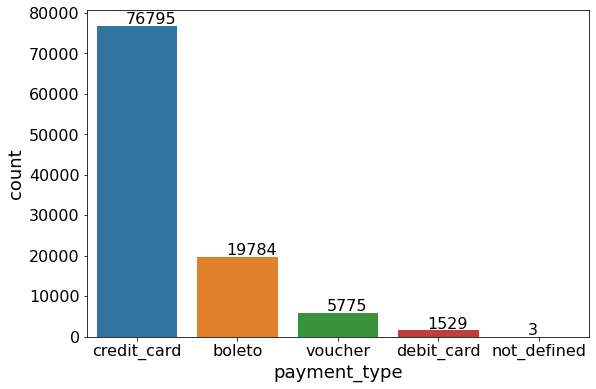

<IPython.core.display.Javascript object>

In [51]:
vbars = payments["payment_type"].value_counts().values
plt.figure(figsize=(9, 6))
sns.countplot(
    x="payment_type", data=payments, order=payments["payment_type"].value_counts().index
)
plt.xlabel("payment_type", fontsize=18)
plt.xticks(fontsize=16)
plt.ylabel("count", fontsize=18)
plt.yticks(fontsize=16)
for i in range(5):
    plt.annotate(text=vbars[i], xy=(i - 0.11, vbars[i] + 500), fontsize=16)
plt.show()

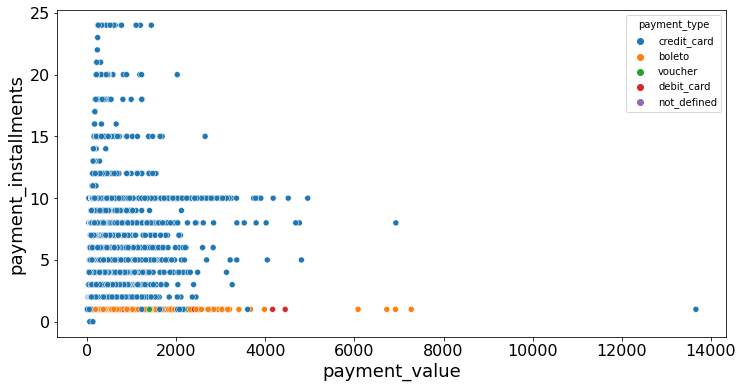

<IPython.core.display.Javascript object>

In [52]:
plt.figure(figsize=(12, 6))
sns.scatterplot(
    x="payment_value", y="payment_installments", data=payments, hue="payment_type"
)
plt.xlabel("payment_value", fontsize=18)
plt.xticks(fontsize=16)
plt.ylabel("payment_installments", fontsize=18)
plt.yticks(fontsize=16)
plt.show()

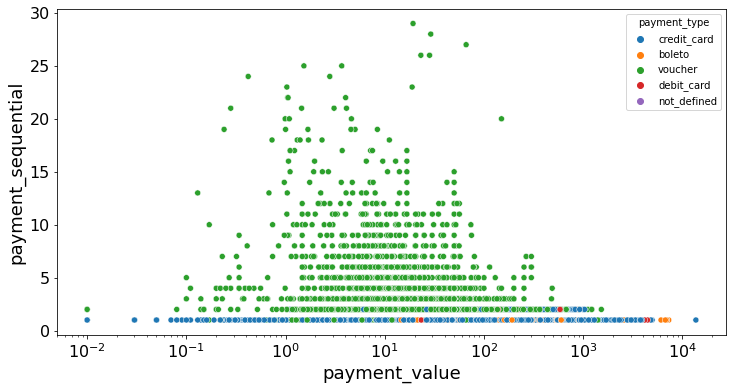

<IPython.core.display.Javascript object>

In [53]:
plt.figure(figsize=(12, 6))
sns.scatterplot(
    x="payment_value", y="payment_sequential", data=payments, hue="payment_type"
)
plt.xlabel("payment_value", fontsize=18)
plt.xticks(fontsize=16)
plt.xscale("log")
plt.ylabel("payment_sequential", fontsize=18)
plt.yticks(fontsize=16)
plt.show()

In [54]:
payments.shape

(103886, 5)

<IPython.core.display.Javascript object>

In [55]:
payments.isna().sum()

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64

<IPython.core.display.Javascript object>

In [56]:
payments.duplicated().sum()

0

<IPython.core.display.Javascript object>

## reviews

In [57]:
reviews.head(1)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59


<IPython.core.display.Javascript object>

In [58]:
reviews["review_score"].value_counts().sort_index(ascending=False)

5    57328
4    19142
3     8179
2     3151
1    11424
Name: review_score, dtype: int64

<IPython.core.display.Javascript object>

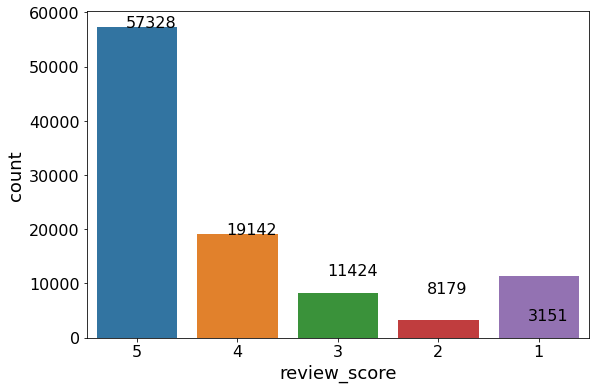

<IPython.core.display.Javascript object>

In [59]:
vbars = reviews["review_score"].value_counts().values
plt.figure(figsize=(9, 6))
sns.countplot(
    x="review_score",
    data=reviews,
    order=sorted(reviews["review_score"].value_counts().index, reverse=True),
)
plt.xlabel("review_score", fontsize=18)
plt.xticks(fontsize=16)
plt.ylabel("count", fontsize=18)
plt.yticks(fontsize=16)
for i in range(5):
    plt.annotate(text=vbars[i], xy=(i - 0.11, vbars[i]), fontsize=16)
plt.show()

In [60]:
reviews.shape

(99224, 7)

<IPython.core.display.Javascript object>

In [61]:
reviews.isna().sum()

review_id                      0
order_id                       0
review_score                   0
review_comment_title       87656
review_comment_message     58247
review_creation_date           0
review_answer_timestamp        0
dtype: int64

<IPython.core.display.Javascript object>

## items

In [62]:
items.head(1)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29


<IPython.core.display.Javascript object>

In [63]:
items["order_id"].value_counts()

8272b63d03f5f79c56e9e4120aec44ef    21
1b15974a0141d54e36626dca3fdc731a    20
ab14fdcfbe524636d65ee38360e22ce8    20
9ef13efd6949e4573a18964dd1bbe7f5    15
428a2f660dc84138d969ccd69a0ab6d5    15
                                    ..
5a0911d70c1f85d3bed0df1bf693a6dd     1
5a082b558a3798d3e36d93bfa8ca1eae     1
5a07264682e0b8fbb3f166edbbffc6e8     1
5a071192a28951b76774e5a760c8c9b7     1
fffe41c64501cc87c801fd61db3f6244     1
Name: order_id, Length: 98666, dtype: int64

<IPython.core.display.Javascript object>

In [64]:
items["product_id"].duplicated().sum()

79699

<IPython.core.display.Javascript object>

In [65]:
items["order_item_id"].value_counts()

1     98666
2      9803
3      2287
4       965
5       460
6       256
7        58
8        36
9        28
10       25
11       17
12       13
13        8
14        7
15        5
16        3
17        3
18        3
19        3
20        3
21        1
Name: order_item_id, dtype: int64

<IPython.core.display.Javascript object>

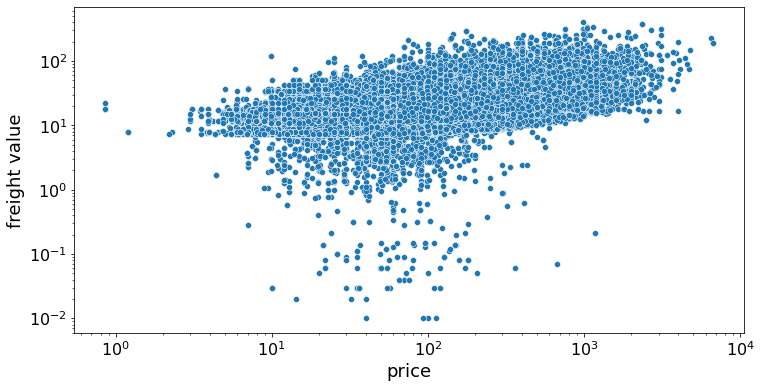

<IPython.core.display.Javascript object>

In [66]:
plt.figure(figsize=(12, 6))
sns.scatterplot(x="price", y="freight_value", data=items)
plt.xlabel("price", fontsize=18)
plt.xticks(fontsize=16)
plt.xscale("log")
plt.ylabel("freight value", fontsize=18)
plt.yticks(fontsize=16)
plt.yscale("log")
plt.show()

In [67]:
items.isna().sum()

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64

<IPython.core.display.Javascript object>

In [68]:
items.shape

(112650, 7)

<IPython.core.display.Javascript object>

## products

In [69]:
products.head(1)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0


<IPython.core.display.Javascript object>

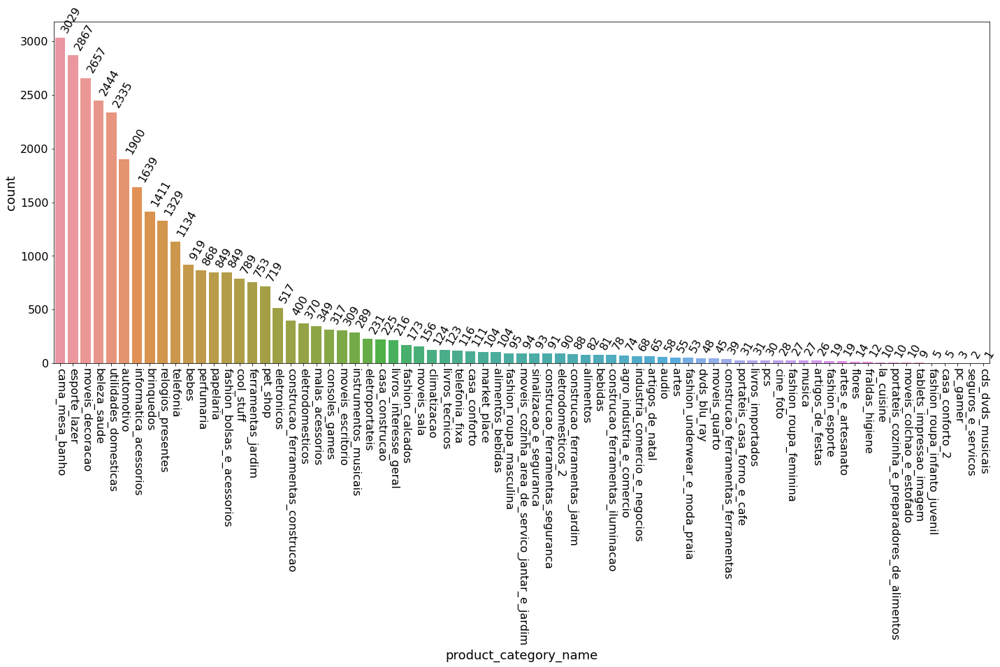

<IPython.core.display.Javascript object>

In [70]:
vbars = products["product_category_name"].value_counts().values
plt.figure(figsize=(24, 9))

sns.countplot(
    x="product_category_name",
    data=products,
    order=products["product_category_name"].value_counts().index,
)
plt.xlabel("product_category_name", fontsize=18)
plt.xticks(fontsize=16, rotation=270)
plt.ylabel("count", fontsize=18)
plt.yticks(fontsize=16)
for i in range(73):
    plt.annotate(text=vbars[i], xy=(i, vbars[i] + 50), fontsize=16, rotation=60)
plt.show()

In [71]:
products.shape

(32951, 9)

<IPython.core.display.Javascript object>

In [72]:
products.isna().sum()

product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64

<IPython.core.display.Javascript object>

## sellers

In [73]:
sellers.head(1)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP


<IPython.core.display.Javascript object>

In [74]:
sellers.shape

(3095, 4)

<IPython.core.display.Javascript object>

In [75]:
sellers.isna().sum()

seller_id                 0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64

<IPython.core.display.Javascript object>

## geolocalization

In [76]:
geo.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


<IPython.core.display.Javascript object>

In [77]:
geo["geolocation_state"].value_counts()

SP    404268
MG    126336
RJ    121169
RS     61851
PR     57859
SC     38328
BA     36045
GO     20139
ES     16748
PE     16432
DF     12986
MT     12031
CE     11674
PA     10853
MS     10431
MA      7853
PB      5538
RN      5041
PI      4549
AL      4183
TO      3576
SE      3563
RO      3478
AM      2432
AC      1301
AP       853
RR       646
Name: geolocation_state, dtype: int64

<IPython.core.display.Javascript object>

In [78]:
geo["geolocation_city"].value_counts()

sao paulo               135800
rio de janeiro           62151
belo horizonte           27805
são paulo                24918
curitiba                 16593
                         ...  
jacuípe                      1
mar vermelho                 1
quebrangulo                  1
poço das trincheiras         1
poxim                        1
Name: geolocation_city, Length: 8011, dtype: int64

<IPython.core.display.Javascript object>

In [79]:
geo.isna().sum()

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64

<IPython.core.display.Javascript object>

In [80]:
geo.shape

(1000163, 5)

<IPython.core.display.Javascript object>

In [81]:
geo["geolocation_zip_code_prefix"].describe().to_frame()

,geolocation_zip_code_prefix
count,1.000163e+06
mean,3.657417e+04
std,3.054934e+04
min,1.001000e+03
25%,1.107500e+04
50%,2.653000e+04
75%,6.350400e+04
max,9.999000e+04


<IPython.core.display.Javascript object>

## category

In [82]:
category["product_category_name"].to_frame()

,product_category_name
0,beleza_saude
1,informatica_acessorios
2,automotivo
3,cama_mesa_banho
4,moveis_decoracao
5,esporte_lazer
6,perfumaria
7,utilidades_domesticas
8,telefonia
9,relogios_presentes


<IPython.core.display.Javascript object>

### <span style='background:yellow'> I'll add {'ignorado':'unknown'}, {'pc_gamer':'pc_gamer'},  {'portateis_cozinha_e_preparadores_de_alimentos':'small_appliances_kitchen_food'} to category data frame<span/>

In [83]:
category = category.append(
    {"product_category_name": "ignorado", "product_category_name_english": "unknown"},
    ignore_index=True,
)
category = category.append(
    {"product_category_name": "pc_gamer", "product_category_name_english": "pc_gamer"},
    ignore_index=True,
)
category = category.append(
    {
        "product_category_name": "portateis_cozinha_e_preparadores_de_alimentos",
        "product_category_name_english": "small_appliances_kitchen_food",
    },
    ignore_index=True,
)

<IPython.core.display.Javascript object>

In [84]:
category.shape

(74, 2)

<IPython.core.display.Javascript object>

In [85]:
category.isna().sum()

product_category_name            0
product_category_name_english    0
dtype: int64

<IPython.core.display.Javascript object>

In [86]:
products.head(1)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0


<IPython.core.display.Javascript object>

### <span style='background:yellow'> I'll replace nan by 'ignorado'<span/>

In [87]:
products["product_category_name"].fillna("ignorado", inplace=True)

<IPython.core.display.Javascript object>

In [88]:
%%time
product_category_name_english=[]
for i in products['product_category_name'].index:
    product_category_name_english.append(category[category['product_category_name'] == products['product_category_name'][i]].product_category_name_english.values[0])

CPU times: user 4.78 s, sys: 195 ms, total: 4.98 s
Wall time: 4.74 s


<IPython.core.display.Javascript object>

In [89]:
products["product_category_name_english"] = product_category_name_english
products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumery
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0,art
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0,sports_leisure
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0,baby
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0,housewares


<IPython.core.display.Javascript object>

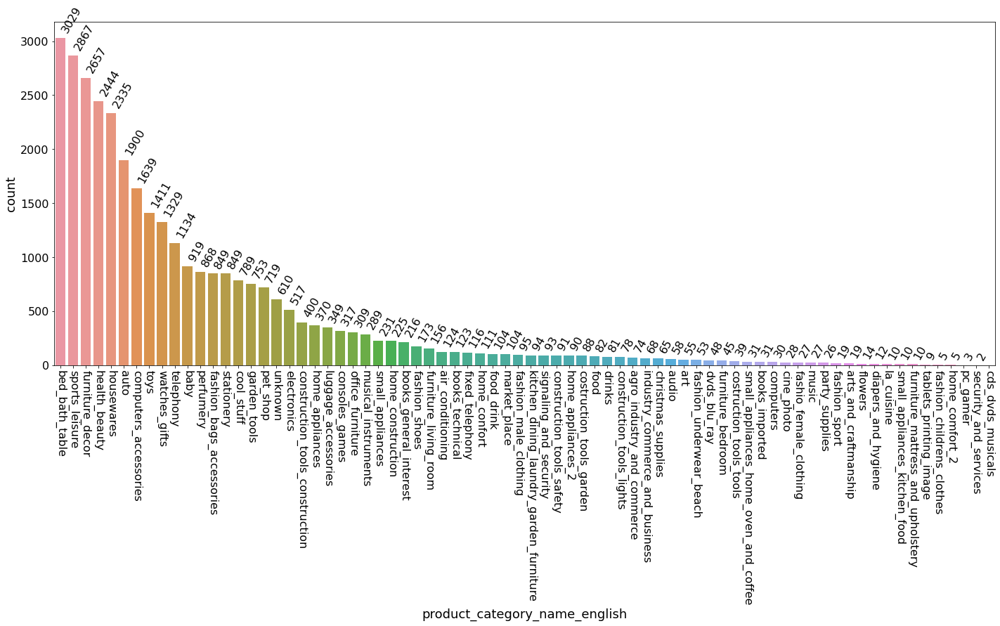

<IPython.core.display.Javascript object>

In [90]:
vbars = products["product_category_name_english"].value_counts().values
plt.figure(figsize=(24, 9))
sns.countplot(
    x="product_category_name_english",
    data=products,
    order=products["product_category_name_english"].value_counts().index,
)
plt.xlabel("product_category_name_english", fontsize=18)
plt.xticks(fontsize=16, rotation=270)
plt.ylabel("count", fontsize=18)
plt.yticks(fontsize=16)
for i in range(73):
    plt.annotate(text=vbars[i], xy=(i, vbars[i] + 50), fontsize=16, rotation=60)
plt.show()

# <a name="C4">Création un dataset globale</a>

## <span style='background:red'> creat 'data' dataframe based on _"orders dataframe"_ for clustering <span/>

In [91]:
data = orders.drop(
    columns=[
        "order_approved_at",
        "order_approved_at",
        "order_delivered_carrier_date",
        "order_delivered_customer_date",
        "order_estimated_delivery_date",
    ]
)

<IPython.core.display.Javascript object>

In [92]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 18 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       99441 non-null  object        
 1   customer_id                    99441 non-null  object        
 2   order_status                   99441 non-null  object        
 3   order_purchase_timestamp       99441 non-null  datetime64[ns]
 4   order_approved_at              99281 non-null  datetime64[ns]
 5   order_delivered_carrier_date   97658 non-null  datetime64[ns]
 6   order_delivered_customer_date  96476 non-null  datetime64[ns]
 7   order_estimated_delivery_date  99441 non-null  datetime64[ns]
 8   order_purchase_year            99441 non-null  int64         
 9   order_purchase_weekday         99441 non-null  object        
 10  order_purchase_month           99441 non-null  object        
 11  order_purchase_

<IPython.core.display.Javascript object>

In [93]:
data = data.merge(customers, on="customer_id")

<IPython.core.display.Javascript object>

In [94]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 18 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   order_id                   99441 non-null  object        
 1   customer_id                99441 non-null  object        
 2   order_status               99441 non-null  object        
 3   order_purchase_timestamp   99441 non-null  datetime64[ns]
 4   order_purchase_year        99441 non-null  int64         
 5   order_purchase_weekday     99441 non-null  object        
 6   order_purchase_month       99441 non-null  object        
 7   order_purchase_ampm        99441 non-null  object        
 8   order_purchase_day_month   99441 non-null  object        
 9   order_purchase_day_year    99441 non-null  object        
 10  delivery_time              99441 non-null  int64         
 11  order_purchase_mm          99441 non-null  object        
 12  orde

<IPython.core.display.Javascript object>

In [95]:
%%time
data['payment_sequential'] = payments.groupby('order_id')['payment_sequential'].transform(lambda x: x.max())
data['payment_type'] = payments.groupby('order_id')['payment_type'].transform(lambda x: x.max())
data['payment_installments'] = payments.groupby('order_id')['payment_installments'].transform(lambda x: x.max())
data['payment_value'] = payments.groupby('order_id')['payment_value'].transform(lambda x: x.sum())

CPU times: user 26.8 s, sys: 285 ms, total: 27.1 s
Wall time: 27 s


<IPython.core.display.Javascript object>

In [96]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 22 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   order_id                   99441 non-null  object        
 1   customer_id                99441 non-null  object        
 2   order_status               99441 non-null  object        
 3   order_purchase_timestamp   99441 non-null  datetime64[ns]
 4   order_purchase_year        99441 non-null  int64         
 5   order_purchase_weekday     99441 non-null  object        
 6   order_purchase_month       99441 non-null  object        
 7   order_purchase_ampm        99441 non-null  object        
 8   order_purchase_day_month   99441 non-null  object        
 9   order_purchase_day_year    99441 non-null  object        
 10  delivery_time              99441 non-null  int64         
 11  order_purchase_mm          99441 non-null  object        
 12  orde

<IPython.core.display.Javascript object>

In [97]:
data = data.join(reviews.set_index("order_id"), on="order_id")

<IPython.core.display.Javascript object>

In [98]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99992 entries, 0 to 99440
Data columns (total 28 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   order_id                   99992 non-null  object        
 1   customer_id                99992 non-null  object        
 2   order_status               99992 non-null  object        
 3   order_purchase_timestamp   99992 non-null  datetime64[ns]
 4   order_purchase_year        99992 non-null  int64         
 5   order_purchase_weekday     99992 non-null  object        
 6   order_purchase_month       99992 non-null  object        
 7   order_purchase_ampm        99992 non-null  object        
 8   order_purchase_day_month   99992 non-null  object        
 9   order_purchase_day_year    99992 non-null  object        
 10  delivery_time              99992 non-null  int64         
 11  order_purchase_mm          99992 non-null  object        
 12  orde

<IPython.core.display.Javascript object>

In [99]:
data.drop(
    columns=[
        "review_id",
        "review_comment_title",
        "review_comment_message",
        "review_creation_date",
        "review_answer_timestamp",
    ],
    inplace=True,
)

<IPython.core.display.Javascript object>

In [100]:
data.drop_duplicates(subset="order_id", inplace=True)

<IPython.core.display.Javascript object>

In [101]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   order_id                   99441 non-null  object        
 1   customer_id                99441 non-null  object        
 2   order_status               99441 non-null  object        
 3   order_purchase_timestamp   99441 non-null  datetime64[ns]
 4   order_purchase_year        99441 non-null  int64         
 5   order_purchase_weekday     99441 non-null  object        
 6   order_purchase_month       99441 non-null  object        
 7   order_purchase_ampm        99441 non-null  object        
 8   order_purchase_day_month   99441 non-null  object        
 9   order_purchase_day_year    99441 non-null  object        
 10  delivery_time              99441 non-null  int64         
 11  order_purchase_mm          99441 non-null  object        
 12  orde

<IPython.core.display.Javascript object>

In [102]:
data["review_score"].fillna(value=round(reviews["review_score"].mean()), inplace=True)

<IPython.core.display.Javascript object>

In [103]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   order_id                   99441 non-null  object        
 1   customer_id                99441 non-null  object        
 2   order_status               99441 non-null  object        
 3   order_purchase_timestamp   99441 non-null  datetime64[ns]
 4   order_purchase_year        99441 non-null  int64         
 5   order_purchase_weekday     99441 non-null  object        
 6   order_purchase_month       99441 non-null  object        
 7   order_purchase_ampm        99441 non-null  object        
 8   order_purchase_day_month   99441 non-null  object        
 9   order_purchase_day_year    99441 non-null  object        
 10  delivery_time              99441 non-null  int64         
 11  order_purchase_mm          99441 non-null  object        
 12  orde

<IPython.core.display.Javascript object>

In [104]:
%%time
geolocation_lat=[]
geolocation_lng=[]
for i in data['order_id'].index:
    if geo[geo['geolocation_zip_code_prefix']==data['customer_zip_code_prefix'][i]].empty is True:
        geolocation_lat.append(-23.545621)
        geolocation_lng.append(-46.639292)
    else:
        geolocation_lat.append(geo[geo['geolocation_zip_code_prefix']==data['customer_zip_code_prefix'][i]].geolocation_lat.values[0])
        geolocation_lng.append(geo[geo['geolocation_zip_code_prefix']==data['customer_zip_code_prefix'][i]].geolocation_lng.values[0])
data['geolocation_lat'] = geolocation_lat
data['geolocation_lng'] = geolocation_lng
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 25 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   order_id                   99441 non-null  object        
 1   customer_id                99441 non-null  object        
 2   order_status               99441 non-null  object        
 3   order_purchase_timestamp   99441 non-null  datetime64[ns]
 4   order_purchase_year        99441 non-null  int64         
 5   order_purchase_weekday     99441 non-null  object        
 6   order_purchase_month       99441 non-null  object        
 7   order_purchase_ampm        99441 non-null  object        
 8   order_purchase_day_month   99441 non-null  object        
 9   order_purchase_day_year    99441 non-null  object        
 10  delivery_time              99441 non-null  int64         
 11  order_purchase_mm          99441 non-null  object        
 12  orde

<IPython.core.display.Javascript object>

In [105]:
data.to_csv("data_for_clustering.csv")

<IPython.core.display.Javascript object>

# <a name="C5">Geolocalisation des commandes</a>

In [106]:
brazil_map = folium.Map(location=[-16.0, -50.0], zoom_start=4)

display(brazil_map)

<IPython.core.display.Javascript object>

In [107]:
# get the first 10000 orders in the data dataframe
limit = 10000
data_limit = data.iloc[0:limit, :]

<IPython.core.display.Javascript object>

In [108]:
# let's start again with a clean copy of the map of Brazil
brazil_map = folium.Map(location=[-16.0, -50.0], zoom_start=4)

# instantiate a feature group for the orders in the data
commandes = folium.map.FeatureGroup()

# loop through the orders and add each to the commandes feature group
for lat, lng, label in zip(
    data_limit.geolocation_lat, data_limit.geolocation_lng, data_limit.payment_value
):
    commandes.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=2,  # define how big you want the circle markers to be
            color="yellow",
            fill=True,
            popup=label,
            fill_color="blue",
            fill_opacity=0.6,
        )
    )

# add orders to map
brazil_map.add_child(commandes)

<IPython.core.display.Javascript object>

In [109]:
from folium import plugins

# let's start again with a clean copy of the map of Brazil
brazil_map = folium.Map(location=[-16.0, -50.0], zoom_start=4)

# instantiate a mark cluster object for the orders in the data
commandes = plugins.MarkerCluster().add_to(brazil_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label_1, label_2, label_3, label_4 in zip(
    data_limit.geolocation_lat,
    data_limit.geolocation_lng,
    data_limit.payment_value,
    data_limit.order_status,
    data_limit.review_score,
    data_limit.payment_type,
):
    folium.Marker(
        location=[lat, lng], icon=None, popup=[label_1, label_2, label_3, label_4],
    ).add_to(commandes)

# display map
brazil_map

<IPython.core.display.Javascript object>

# <a name="C6">Création un dataset RFM: Recency, Frequency, Monetary</a>

## <span style='background:red'> creat 'data_unique customer' dataframe based on _"orders dataframe"_ for clustering <span/>

In [110]:
data_unique = data.copy()

<IPython.core.display.Javascript object>

In [111]:
%%time

data_unique['total_orders'] = data_unique \
    .groupby('customer_unique_id')['order_id'].transform(lambda x: x.count())


CPU times: user 6.57 s, sys: 96.2 ms, total: 6.67 s
Wall time: 6.62 s


<IPython.core.display.Javascript object>

In [112]:
%%time

data_unique['order_purchase_last_timestamp'] = data_unique \
    .groupby('customer_unique_id')['order_purchase_timestamp'].transform(lambda x: x.max())

CPU times: user 10.4 s, sys: 25.2 ms, total: 10.4 s
Wall time: 10.4 s


<IPython.core.display.Javascript object>

In [113]:
%%time

data_unique['total_payment_value'] = data_unique \
    .groupby('customer_unique_id')['payment_value'].transform(lambda x: x.sum())


CPU times: user 7.53 s, sys: 40.3 ms, total: 7.57 s
Wall time: 7.56 s


<IPython.core.display.Javascript object>

In [114]:
data_unique.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 28 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       99441 non-null  object        
 1   customer_id                    99441 non-null  object        
 2   order_status                   99441 non-null  object        
 3   order_purchase_timestamp       99441 non-null  datetime64[ns]
 4   order_purchase_year            99441 non-null  int64         
 5   order_purchase_weekday         99441 non-null  object        
 6   order_purchase_month           99441 non-null  object        
 7   order_purchase_ampm            99441 non-null  object        
 8   order_purchase_day_month       99441 non-null  object        
 9   order_purchase_day_year        99441 non-null  object        
 10  delivery_time                  99441 non-null  int64         
 11  order_purchase_

<IPython.core.display.Javascript object>

## <span style='background:pink'> creat 'rfm_data' dataframe for clustering <span/>

In [115]:
data_rfm = data_unique[
    [
        "customer_unique_id",
        "order_purchase_last_timestamp",
        "total_orders",
        "total_payment_value",
        "order_purchase_year",
        "order_purchase_mm",
        "order_purchase_year_month",
        "order_purchase_year_week",
    ]
]

<IPython.core.display.Javascript object>

In [116]:
data_rfm.head()

,customer_unique_id,order_purchase_last_timestamp,total_orders,total_payment_value,order_purchase_year,order_purchase_mm,order_purchase_year_month,order_purchase_year_week
0,7c396fd4830fd04220f754e42b4e5bff,2017-10-02 10:56:33,2,185.53,2017,10,2017-10,2017-40
1,af07308b275d755c9edb36a90c618231,2018-07-24 20:41:37,1,24.39,2018,07,2018-07,2018-30
2,3a653a41f6f9fc3d2a113cf8398680e8,2018-08-08 08:38:49,1,65.71,2018,08,2018-08,2018-32
3,7c142cf63193a1473d2e66489a9ae977,2017-11-18 19:28:06,1,107.78,2017,11,2017-11,2017-46
4,72632f0f9dd73dfee390c9b22eb56dd6,2018-02-13 21:18:39,1,128.45,2018,02,2018-02,2018-07


<IPython.core.display.Javascript object>

In [117]:
data_rfm.drop_duplicates(subset="customer_unique_id", inplace=True)

<IPython.core.display.Javascript object>

In [118]:
data_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96096 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_unique_id             96096 non-null  object        
 1   order_purchase_last_timestamp  96096 non-null  datetime64[ns]
 2   total_orders                   96096 non-null  int64         
 3   total_payment_value            96096 non-null  float64       
 4   order_purchase_year            96096 non-null  int64         
 5   order_purchase_mm              96096 non-null  object        
 6   order_purchase_year_month      96096 non-null  object        
 7   order_purchase_year_week       96096 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(2), object(4)
memory usage: 6.6+ MB


<IPython.core.display.Javascript object>

In [119]:
snapshot = data_rfm["order_purchase_last_timestamp"].max()

<IPython.core.display.Javascript object>

In [120]:
snapshot

Timestamp('2018-10-17 17:30:18')

<IPython.core.display.Javascript object>

In [121]:
data_rfm["recency"] = (snapshot - data_rfm["order_purchase_last_timestamp"]).dt.days + 1

<IPython.core.display.Javascript object>

In [122]:
data_rfm["recency"]

0        381
1         85
2         71
3        333
4        246
        ... 
99436    588
99437    254
99438    417
99439    282
99440    223
Name: recency, Length: 96096, dtype: int64

<IPython.core.display.Javascript object>

In [123]:
data_rfm["frequency"] = data_rfm["total_orders"]

<IPython.core.display.Javascript object>

In [124]:
data_rfm["monetary"] = data_rfm["total_payment_value"]

<IPython.core.display.Javascript object>

In [125]:
data_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96096 entries, 0 to 99440
Data columns (total 11 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_unique_id             96096 non-null  object        
 1   order_purchase_last_timestamp  96096 non-null  datetime64[ns]
 2   total_orders                   96096 non-null  int64         
 3   total_payment_value            96096 non-null  float64       
 4   order_purchase_year            96096 non-null  int64         
 5   order_purchase_mm              96096 non-null  object        
 6   order_purchase_year_month      96096 non-null  object        
 7   order_purchase_year_week       96096 non-null  object        
 8   recency                        96096 non-null  int64         
 9   frequency                      96096 non-null  int64         
 10  monetary                       96096 non-null  float64       
dtypes: datetime64[n

<IPython.core.display.Javascript object>

In [126]:
rfm = data_rfm[["recency", "frequency", "monetary"]]

<IPython.core.display.Javascript object>

In [127]:
rfm

,recency,frequency,monetary
0,381,2,185.53
1,85,1,24.39
2,71,1,65.71
3,333,1,107.78
4,246,1,128.45
...,...,...,...
99436,588,1,43.70
99437,254,1,31.43
99438,417,1,57.97
99439,282,1,71.35


<IPython.core.display.Javascript object>

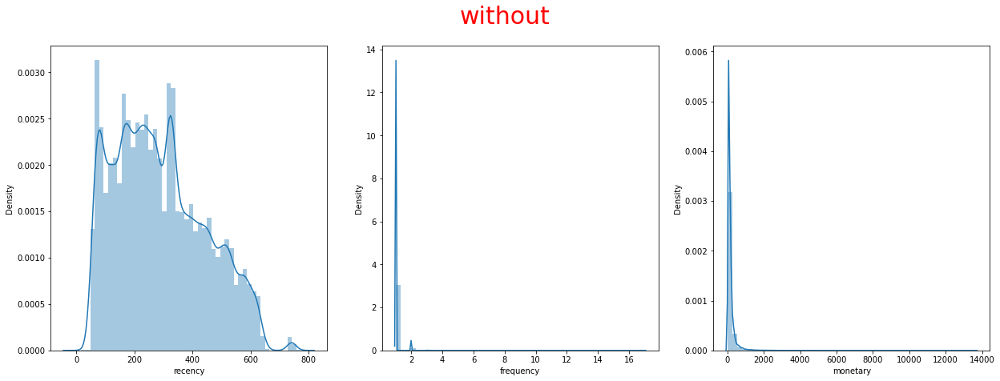

<IPython.core.display.Javascript object>

In [128]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(rfm["recency"])

plt.subplot(132)
sns.distplot(rfm["frequency"])

plt.subplot(133)
sns.distplot(rfm["monetary"])

plt.suptitle("without", fontsize=30, c="r")

plt.show()

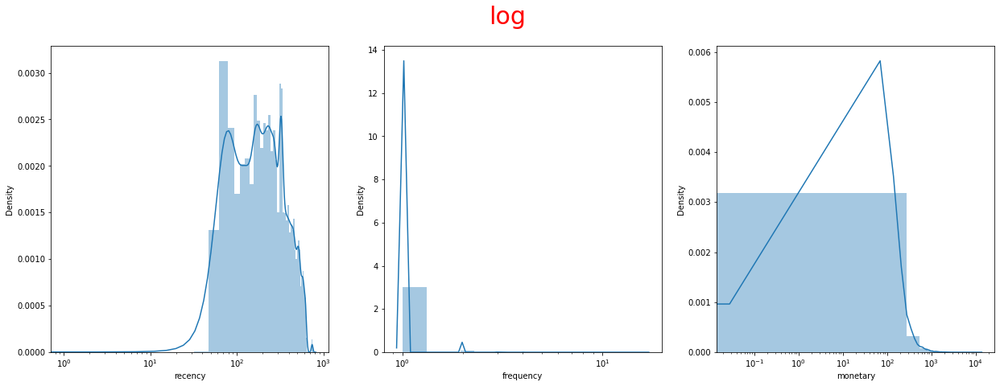

<IPython.core.display.Javascript object>

In [129]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(rfm["recency"])
plt.xscale("log")

plt.subplot(132)
sns.distplot(rfm["frequency"])
plt.xscale("log")

plt.subplot(133)
sns.distplot(rfm["monetary"])
plt.xscale("log")

plt.suptitle("log", fontsize=30, c="r")

plt.show()

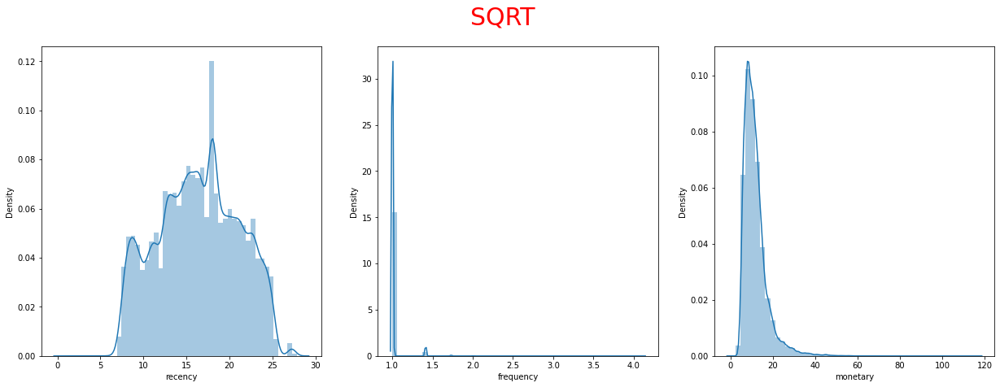

<IPython.core.display.Javascript object>

In [130]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(np.sqrt(rfm["recency"]))

plt.subplot(132)
sns.distplot(np.sqrt(rfm["frequency"]))

plt.subplot(133)
sns.distplot(np.sqrt(rfm["monetary"]))

plt.suptitle("SQRT", fontsize=30, c="r")

plt.show()

In [131]:
rfm["recency"].min()

1

<IPython.core.display.Javascript object>

In [132]:
rfm.drop(index=rfm[rfm["monetary"] == 0].index, inplace=True)

<IPython.core.display.Javascript object>

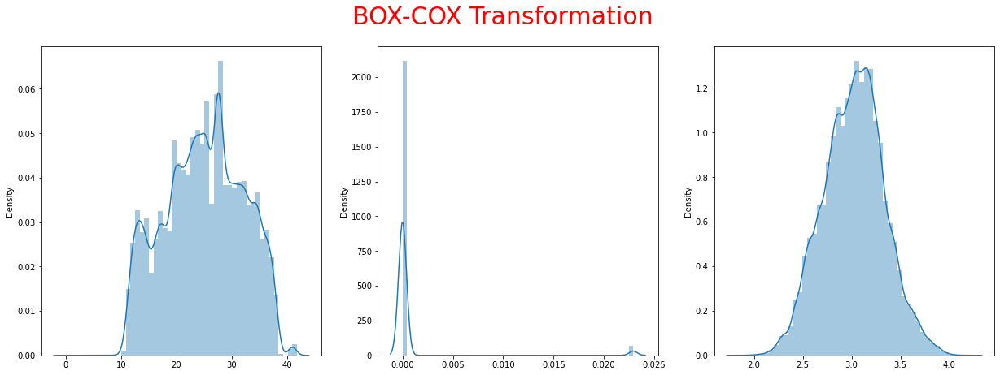

<IPython.core.display.Javascript object>

In [133]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(stats.boxcox(rfm["recency"])[0])

plt.subplot(132)
sns.distplot(stats.boxcox(rfm["frequency"])[0])

plt.subplot(133)
sns.distplot(stats.boxcox(rfm["monetary"])[0])

plt.suptitle("BOX-COX Transformation", fontsize=30, c="r")

plt.show()

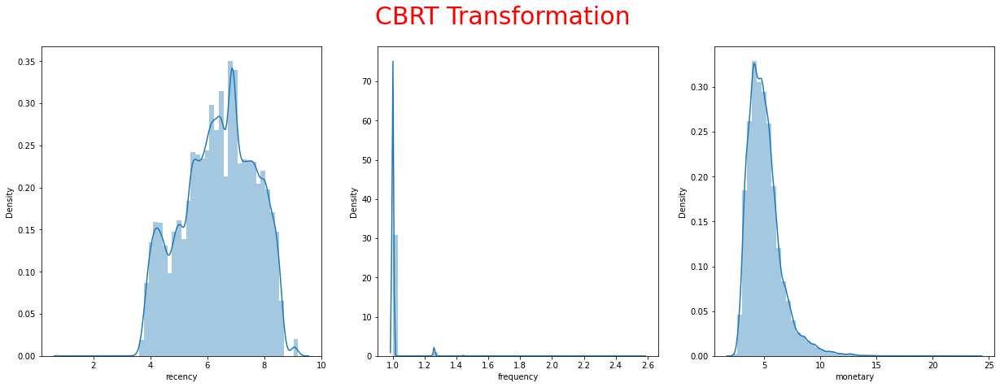

<IPython.core.display.Javascript object>

In [134]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(np.cbrt(rfm["recency"]))

plt.subplot(132)
sns.distplot(np.cbrt(rfm["frequency"]))

plt.subplot(133)
sns.distplot(np.cbrt(rfm["monetary"]))

plt.suptitle("CBRT Transformation", fontsize=30, c="r")

plt.show()

## <span style='background:pink'> export rfm for clustering <span/>

In [135]:
rfm.to_csv("rfm_for_clustering.csv", index=False)

<IPython.core.display.Javascript object>

## <a name="C7">dataset pour le maintenance de segmentation</a>

## <span style='background:pink'> export rfm_date for clustering maintenance <span/>

In [136]:
data_rfm["year"] = data_rfm["order_purchase_year"]
data_rfm["month"] = data_rfm["order_purchase_mm"]
data_rfm["year_month"] = data_rfm["order_purchase_year_month"]
data_rfm["year_week"] = data_rfm["order_purchase_year_week"]

<IPython.core.display.Javascript object>

In [137]:
rfm_date = data_rfm[
    ["recency", "frequency", "monetary", "year", "month", "year_month", "year_week"]
]

<IPython.core.display.Javascript object>

In [138]:
rfm_date.to_csv("rfm_date_for_clustering_ari_score.csv", index=False)

<IPython.core.display.Javascript object>

# <a name="C8">Création un dataset RFMS: Recency, Frequency, Monetary, Score</a>

## <span style='background:pink'> add score to rfm_data for clustering --> rfms <span/>

In [139]:
rfms = rfm.copy()

<IPython.core.display.Javascript object>

In [140]:
rfms["score"] = data_unique.groupby("customer_unique_id")["review_score"].transform(
    lambda x: x.max()
)

<IPython.core.display.Javascript object>

In [141]:
rfms.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96093 entries, 0 to 99440
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   recency    96093 non-null  int64  
 1   frequency  96093 non-null  int64  
 2   monetary   96093 non-null  float64
 3   score      96093 non-null  float64
dtypes: float64(2), int64(2)
memory usage: 3.7 MB


<IPython.core.display.Javascript object>

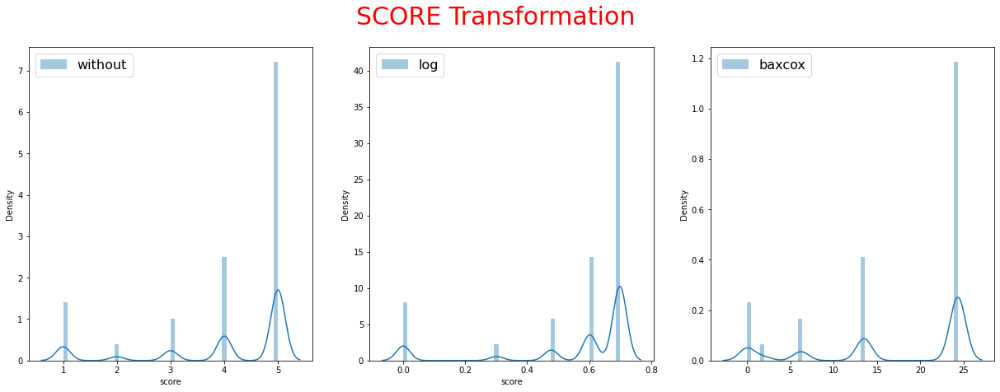

<IPython.core.display.Javascript object>

In [142]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(rfms["score"], label="without")
plt.legend(fontsize=16)

plt.subplot(132)
sns.distplot(np.log10(rfms["score"]), label="log")
plt.legend(fontsize=16)

plt.subplot(133)
sns.distplot(stats.boxcox(rfms["score"])[0], label="baxcox")
plt.legend(fontsize=16)

plt.suptitle("SCORE Transformation", fontsize=30, c="r")

plt.show()

In [143]:
rfms.to_csv("rfms_for_clustering.csv", index=False)

<IPython.core.display.Javascript object>

## <a name="C8">Création un dataset RFMSD: Recency, Frequency, Monetary, Score, Delevery_time</a>

## <span style='background:pink'> add delivery to rfms data for clustering --> rfmsd <span/>

In [144]:
rfmsd = rfms.copy()

<IPython.core.display.Javascript object>

In [145]:
rfmsd["delivery"] = data_unique.groupby("customer_unique_id")[
    "delivery_time"
].transform(lambda x: x.max())

<IPython.core.display.Javascript object>

In [181]:
rfmsd.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96080 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   recency    96080 non-null  int64  
 1   frequency  96080 non-null  int64  
 2   monetary   96080 non-null  float64
 3   score      96080 non-null  float64
 4   delivery   96080 non-null  int64  
dtypes: float64(2), int64(3)
memory usage: 4.4 MB


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [177]:
rfmsd[rfmsd["delivery"] == 0].index

Int64Index([  395,   735, 31522, 37753, 38792, 41803, 48767, 48878, 51067,
            69291, 69580, 91710, 97428],
           dtype='int64')

<IPython.core.display.Javascript object>

In [178]:
rfmsd.drop(index=rfmsd[rfmsd["delivery"] == 0].index, inplace=True)

<IPython.core.display.Javascript object>

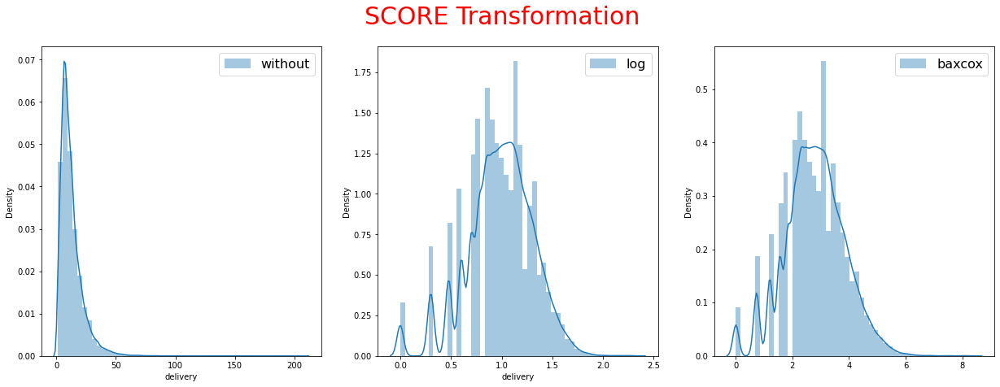

<IPython.core.display.Javascript object>

In [179]:
plt.figure(figsize=(21, 7))

plt.subplot(131)
sns.distplot(rfmsd["delivery"], label="without")
plt.legend(fontsize=16)

plt.subplot(132)
sns.distplot(np.log10(rfmsd["delivery"]), label="log")
plt.legend(fontsize=16)

plt.subplot(133)
sns.distplot(stats.boxcox(rfmsd["delivery"])[0], label="baxcox")
plt.legend(fontsize=16)

plt.suptitle("SCORE Transformation", fontsize=30, c="r")

plt.show()

In [180]:
rfmsd.to_csv("rfmsd_for_clustering.csv", index=False)

<IPython.core.display.Javascript object>

# Fin